<a href="https://colab.research.google.com/github/pscabral/IFMASOFTEX_1/blob/main/Yolo8_v1.6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install mega.py

from mega import Mega

# Crie uma instância da classe Mega
mega = Mega()

# Cole o link completo do Mega.nz (incluindo a chave)
url = "https://mega.nz/file/tjFXyboL#esuWnbddRmKY4MXwVY79IqBvAzdhwiI1RwmZ98izVDU"

# Use o link completo para fazer o download
mega.download_url(url)

!unzip ClassificationFridge.v2i.yolov8.zip

In [2]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 663.2/663.2 kB 13.0 MB/s eta 0:00:00


In [3]:
import os
import random
import pandas as pd
from PIL import Image
import cv2
from ultralytics import YOLO
from IPython.display import Video
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style='darkgrid')
import pathlib
import glob
from tqdm.notebook import trange, tqdm
import warnings
warnings.filterwarnings('ignore')
import shutil
from shutil import copyfile
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
from PIL import Image

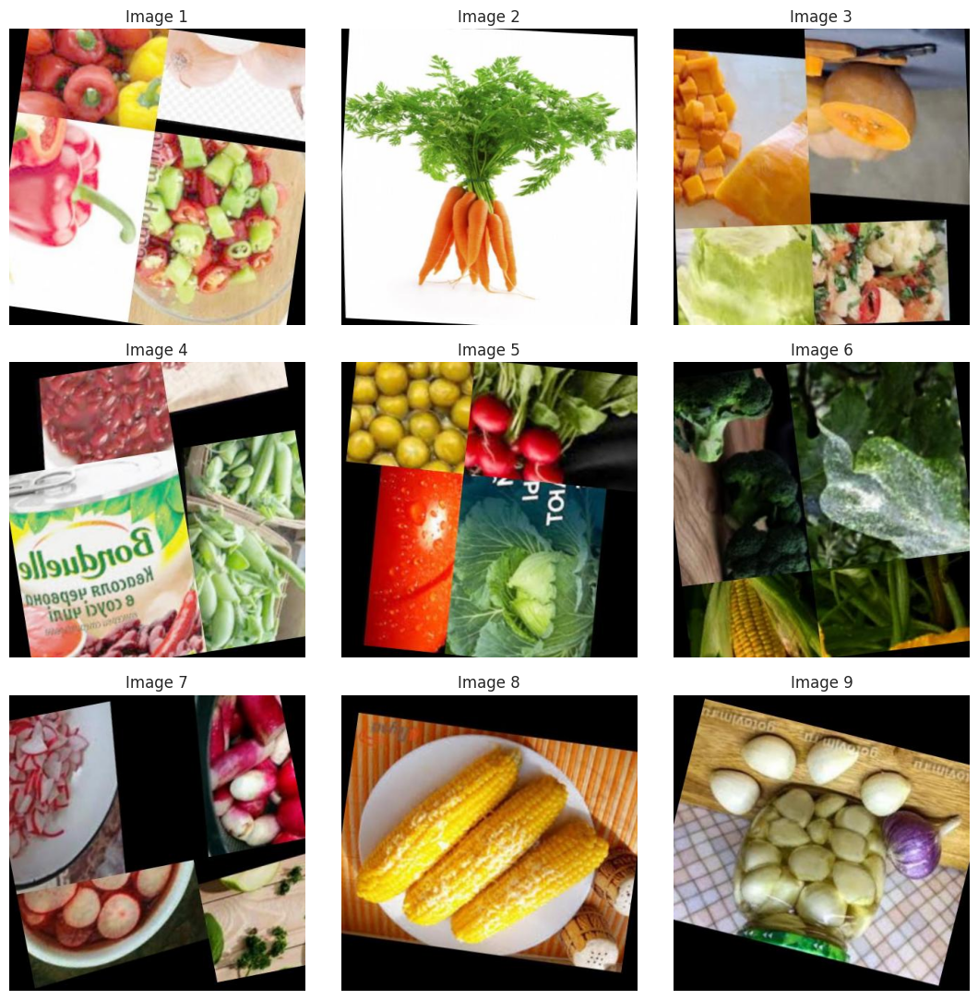

In [4]:
Image_dir = '/content/ClassificationFridge.v2i/train/images'

num_samples = 9
image_files = os.listdir(Image_dir)

# Randomly select num_samples images
rand_images = random.sample(image_files, num_samples)

fig, axes = plt.subplots(3, 3, figsize=(11, 11))

for i in range(num_samples):
    image = rand_images[i]
    ax = axes[i // 3, i % 3]
    ax.imshow(plt.imread(os.path.join(Image_dir, image)))
    ax.set_title(f'Image {i+1}')
    ax.axis('off')

plt.tight_layout()
plt.show()

In [5]:
image = cv2.imread("/content/ClassificationFridge.v2i/train/images/--------------------------12_jpg.rf.0a7bc417f421c34584d9e6b292c30bed.jpg")
h, w, c = image.shape
print(f"The image has dimensions {w}x{h} and {c} channels.")

The image has dimensions 416x416 and 3 channels.


100%|██████████| 6.23M/6.23M [00:00<00:00, 184MB/s]



image 1/1 /content/ClassificationFridge.v2i/train/images/--------------------------12_jpg.rf.0a7bc417f421c34584d9e6b292c30bed.jpg: 416x416 (no detections), 182.3ms
Speed: 7.6ms preprocess, 182.3ms inference, 17.4ms postprocess per image at shape (1, 3, 416, 416)


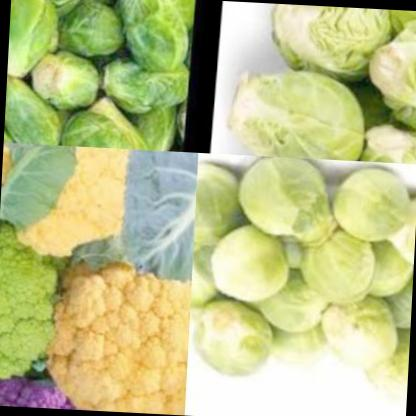

In [6]:
model = YOLO("yolov8n.pt")

# Use the model to detect object
image = "/content/ClassificationFridge.v2i/train/images/--------------------------12_jpg.rf.0a7bc417f421c34584d9e6b292c30bed.jpg"
result_predict = model.predict(source = image, imgsz=(416))

# show results
plot = result_predict[0].plot()
plot = cv2.cvtColor(plot, cv2.COLOR_BGR2RGB)
display(Image.fromarray(plot))

In [7]:
pip install -U albumentations

In [8]:
import albumentations as A
import cv2

# Declare an augmentation pipeline
transform = A.Compose([
    A.RandomCrop(width=256, height=256),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
])

# Read an image with OpenCV and convert it to the RGB colorspace
image = cv2.imread("/content/ClassificationFridge.v2i/train/images/--------------------------12_jpg.rf.0a7bc417f421c34584d9e6b292c30bed.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Augment an image
transformed = transform(image=image)
transformed_image = transformed["image"]

In [9]:
Final_model = YOLO('yolov8n.pt')
Result_Final_model = Final_model.train(data="/content/ClassificationFridge.v2i/data.yaml", epochs=20, imgsz=416, batch=64, lr0=0.0001, dropout=0.15, device='cpu')


Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (AMD EPYC 7B12)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/ClassificationFridge.v2i/data.yaml, epochs=20, time=None, patience=50, batch=64, imgsz=416, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.15, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True

100%|██████████| 755k/755k [00:00<00:00, 42.1MB/s]


Overriding model.yaml nc=80 with nc=32

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

train: Scanning /content/ClassificationFridge.v2i/train/labels... 20295 images, 11 backgrounds, 0 corrupt: 100%|██████████| 20295/20295 [00:16<00:00, 1194.20it/s]

train: WARNING ⚠️ /content/ClassificationFridge.v2i/train/images/-----------------2_jpg.rf.6bc03833c69c484cbbf7bc1ca69a1e77.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/ClassificationFridge.v2i/train/images/-----------------2_jpg.rf.76b3b9695a8ae0e8bad7b0a88056b72e.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/ClassificationFridge.v2i/train/images/-----------------2_jpg.rf.e2581874bf02ee136dde6cc38072a666.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/ClassificationFridge.v2i/train/images/-----------------38_jpg.rf.48576d1b3554727f08b296403a5d02bf.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/ClassificationFridge.v2i/train/images/-----------------38_jpg.rf.e703760313f7938fc9eb0392a88d2e9d.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/ClassificationFridge.v2i/train/images/-----------------40_jpg.rf.19de45ffc66ed3e68a65ed078ef99051.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/ClassificationFridge.v2i/train/ima

train: New cache created: /content/ClassificationFridge.v2i/train/labels.cache
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 265, len(boxes) = 141677. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/ClassificationFridge.v2i/valid/labels... 1993 images, 1 backgrounds, 0 corrupt: 100%|██████████| 1993/1993 [00:01<00:00, 1146.59it/s]

val: WARNING ⚠️ /content/ClassificationFridge.v2i/valid/images/-----------------36_jpg.rf.ed45940922023a175033cf74a823b97a.jpg: 1 duplicate labels removed
val: WARNING ⚠️ /content/ClassificationFridge.v2i/valid/images/--------25_jpg.rf.e8cb215926d35fbf76446eb9edf56941.jpg: 1 duplicate labels removed


val: New cache created: /content/ClassificationFridge.v2i/valid/labels.cache
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 16, len(boxes) = 13835. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000278, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20         0G      1.397      3.959      1.496         96        416: 100%|██████████| 318/318 [25:38<00:00,  4.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:00<00:00,  3.77s/it]


                   all       1993      13835      0.364      0.234      0.155     0.0893

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20         0G      1.332      2.555      1.463         85        416: 100%|██████████| 318/318 [25:29<00:00,  4.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:04<00:00,  4.03s/it]


                   all       1993      13835      0.497       0.38      0.358      0.224

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20         0G      1.257      2.033      1.398         97        416: 100%|██████████| 318/318 [25:15<00:00,  4.76s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:05<00:00,  4.08s/it]


                   all       1993      13835      0.521      0.446      0.424      0.259

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20         0G      1.217      1.817      1.357         76        416: 100%|██████████| 318/318 [25:08<00:00,  4.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:00<00:00,  3.76s/it]


                   all       1993      13835      0.578      0.521      0.525      0.333

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20         0G      1.192      1.677      1.331         87        416: 100%|██████████| 318/318 [25:10<00:00,  4.75s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:01<00:00,  3.83s/it]


                   all       1993      13835      0.683       0.56      0.607      0.399

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20         0G      1.167      1.583      1.312         68        416: 100%|██████████| 318/318 [25:38<00:00,  4.84s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:02<00:00,  3.91s/it]


                   all       1993      13835      0.632      0.556       0.59      0.374

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20         0G      1.149      1.499      1.297         53        416: 100%|██████████| 318/318 [25:17<00:00,  4.77s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:01<00:00,  3.86s/it]


                   all       1993      13835      0.717      0.604      0.683      0.446

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20         0G      1.137      1.437      1.287         87        416: 100%|██████████| 318/318 [26:08<00:00,  4.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:02<00:00,  3.92s/it]


                   all       1993      13835      0.689      0.627       0.68      0.452

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20         0G      1.127      1.379      1.277         89        416: 100%|██████████| 318/318 [26:15<00:00,  4.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:01<00:00,  3.83s/it]


                   all       1993      13835      0.741      0.655      0.724       0.47

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20         0G      1.115      1.338      1.268         85        416: 100%|██████████| 318/318 [26:27<00:00,  4.99s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:03<00:00,  3.96s/it]


                   all       1993      13835      0.761      0.657      0.736      0.489
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20         0G      1.094      1.139      1.268         59        416: 100%|██████████| 318/318 [25:59<00:00,  4.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:01<00:00,  3.83s/it]


                   all       1993      13835       0.77        0.7       0.77      0.511

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20         0G      1.071      1.064      1.249         27        416: 100%|██████████| 318/318 [26:13<00:00,  4.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:07<00:00,  4.24s/it]


                   all       1993      13835      0.818      0.684      0.778      0.529

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20         0G      1.055      1.018      1.238         32        416: 100%|██████████| 318/318 [28:06<00:00,  5.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:10<00:00,  4.39s/it]


                   all       1993      13835      0.803      0.707       0.79      0.541

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20         0G      1.043     0.9823      1.227         51        416: 100%|██████████| 318/318 [28:19<00:00,  5.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:10<00:00,  4.41s/it]


                   all       1993      13835      0.804       0.71      0.795      0.545

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20         0G      1.028      0.945      1.219         43        416: 100%|██████████| 318/318 [29:12<00:00,  5.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:12<00:00,  4.54s/it]


                   all       1993      13835       0.79      0.721      0.802      0.551

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20         0G      1.014     0.9106      1.208         37        416: 100%|██████████| 318/318 [29:38<00:00,  5.59s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:12<00:00,  4.53s/it]


                   all       1993      13835      0.827      0.735       0.82      0.562

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20         0G     0.9991     0.8889      1.198         65        416: 100%|██████████| 318/318 [30:23<00:00,  5.74s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:11<00:00,  4.49s/it]


                   all       1993      13835      0.844      0.731      0.826      0.572

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20         0G     0.9902     0.8638      1.191         43        416: 100%|██████████| 318/318 [32:01<00:00,  6.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:17<00:00,  4.86s/it]


                   all       1993      13835       0.84      0.732      0.825      0.569

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20         0G     0.9792     0.8389      1.185         34        416: 100%|██████████| 318/318 [29:48<00:00,  5.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:09<00:00,  4.33s/it]


                   all       1993      13835       0.85      0.739      0.831      0.579

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20         0G     0.9726     0.8225      1.176         35        416: 100%|██████████| 318/318 [28:59<00:00,  5.47s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:11<00:00,  4.47s/it]


                   all       1993      13835      0.844      0.753      0.836      0.584

20 epochs completed in 9.460 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (AMD EPYC 7B12)
Model summary (fused): 168 layers, 3011888 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [01:00<00:00,  3.77s/it]


                   all       1993      13835      0.841      0.752      0.836      0.584
              Cucumber       1993         44      0.886      0.909      0.944      0.554
               avocado       1993        597      0.851      0.836      0.895      0.583
                 basil       1993         34      0.935      0.912      0.958      0.688
                 beans       1993        264      0.847      0.649      0.746      0.574
                  beet       1993        516      0.833      0.812      0.871        0.6
           bell pepper       1993        587       0.85      0.853       0.89      0.646
              broccoli       1993        384      0.818      0.656      0.764      0.518
          brus capusta       1993        364      0.824      0.629       0.75        0.5
               cabbage       1993        324      0.821      0.759      0.816        0.6
                carrot       1993        781      0.812      0.636      0.766      0.463
           cauliflowe

In [10]:
print('result of training')
tpaths2=[]
for dirname, _, filenames in os.walk('/content/runs/detect/train'):
    for filename in filenames:
        if filename[-4:]=='.png' or filename[-4:]=='.jpg':
            tpaths2+=[(os.path.join(dirname, filename))]
tpaths2=sorted(tpaths2)
print(tpaths2[0])

result of training
/content/runs/detect/train/F1_curve.png


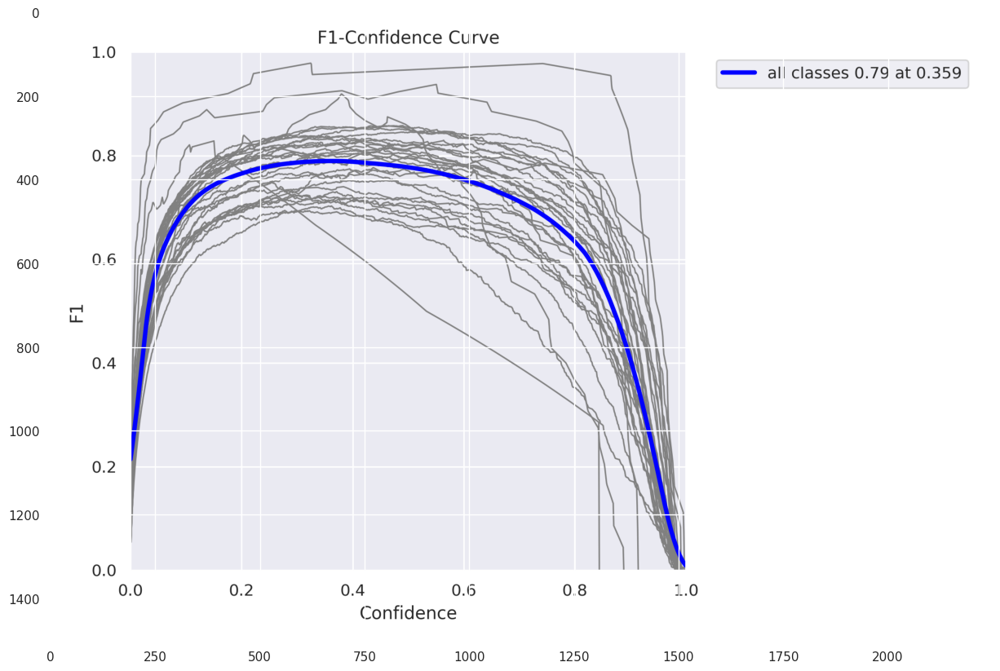

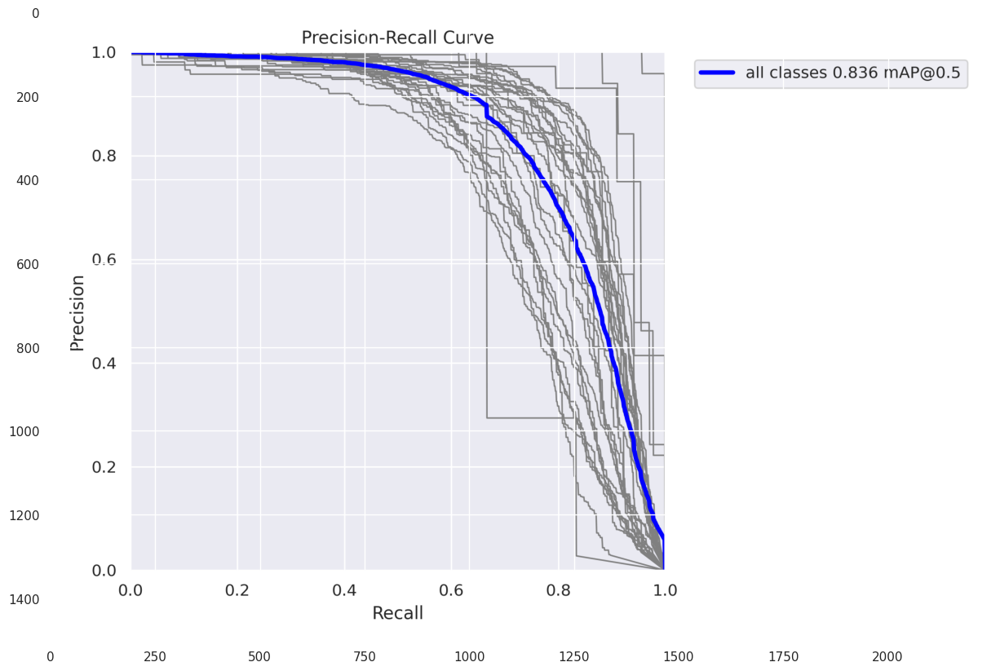

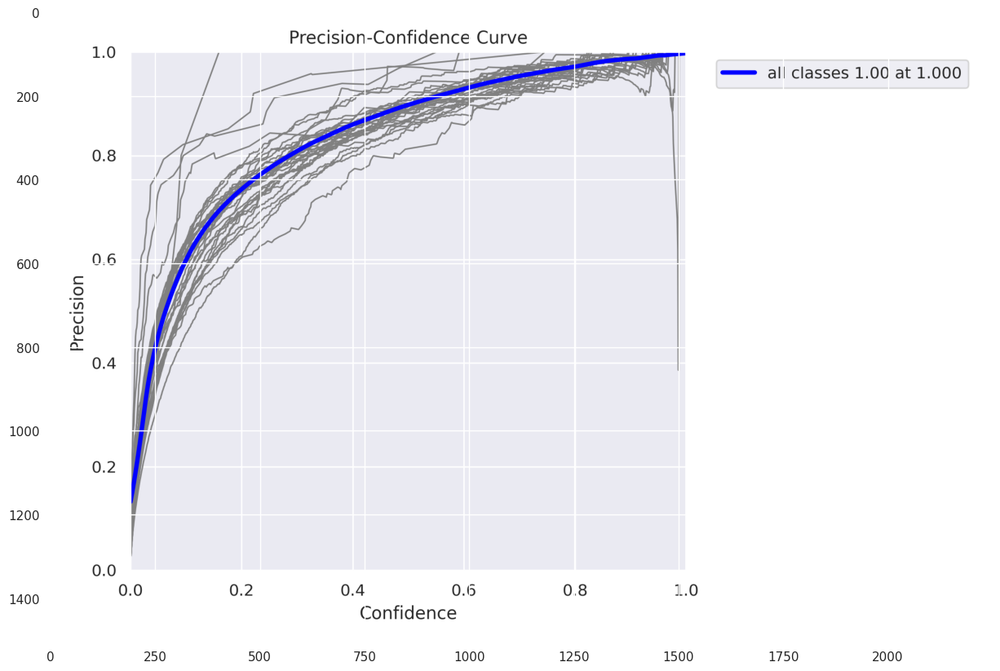

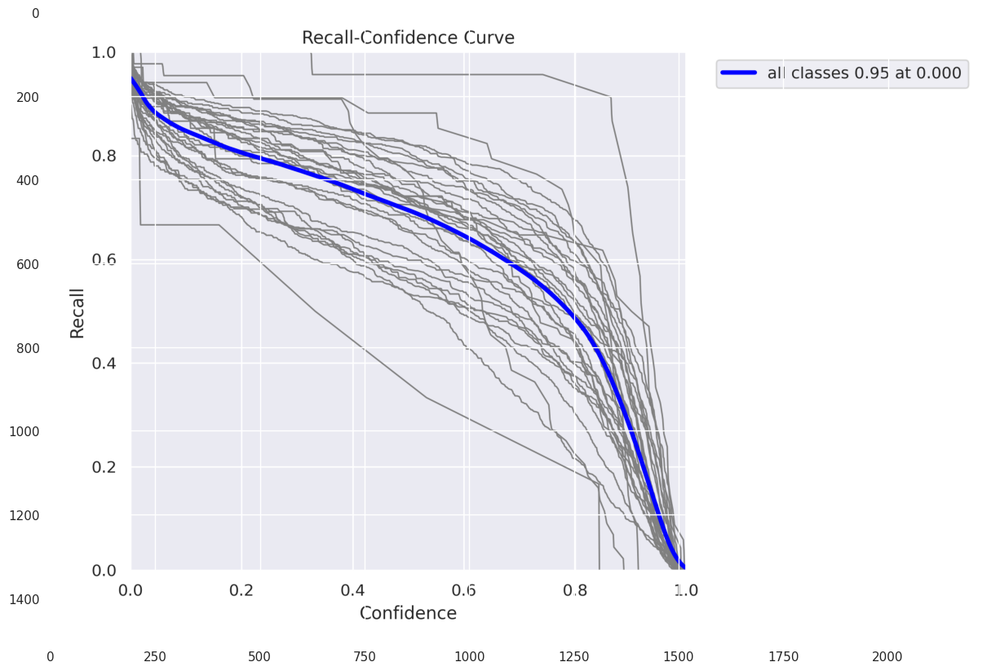

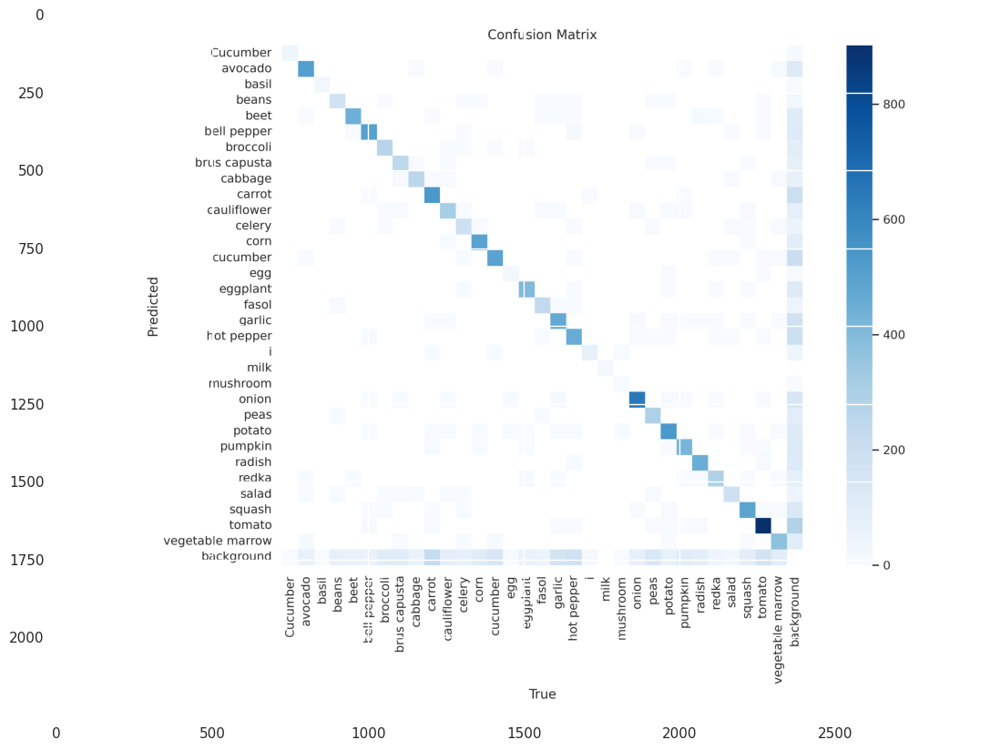

...

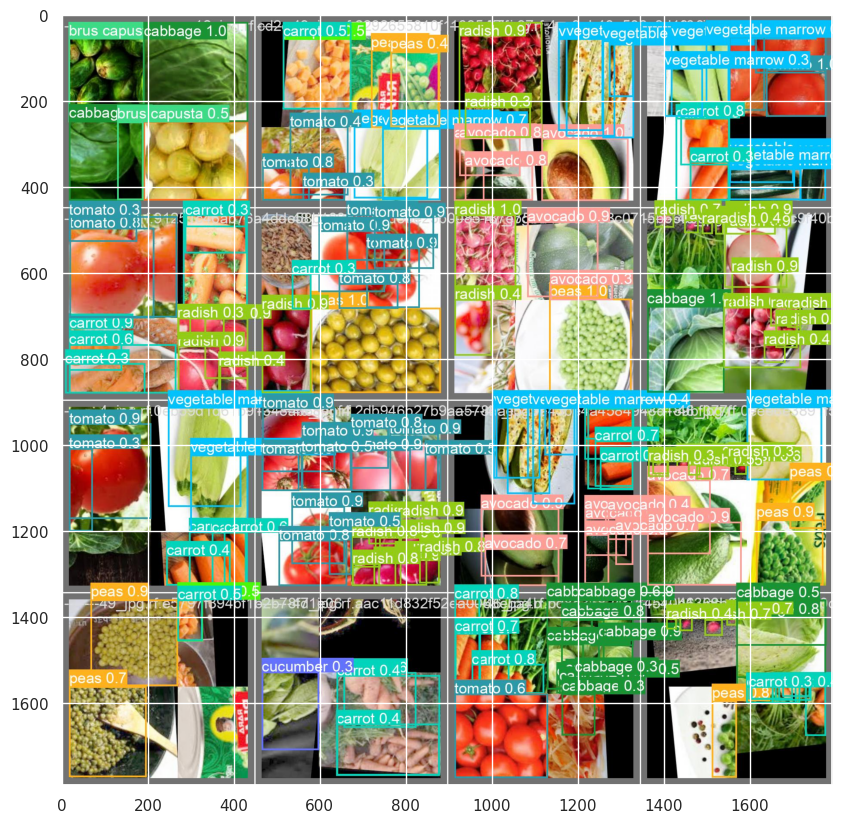

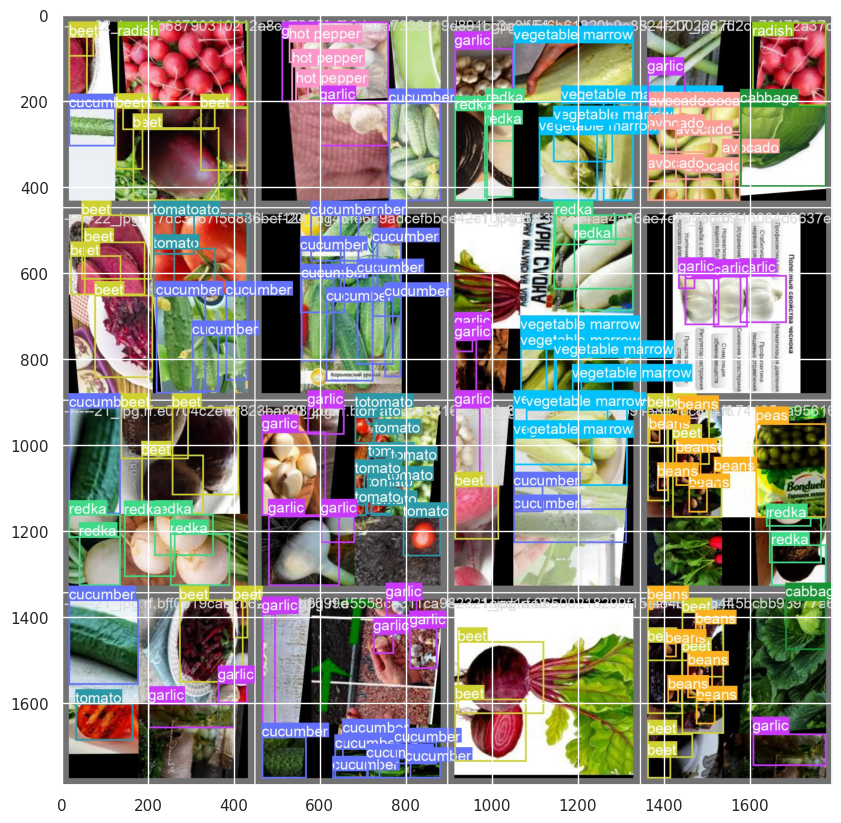

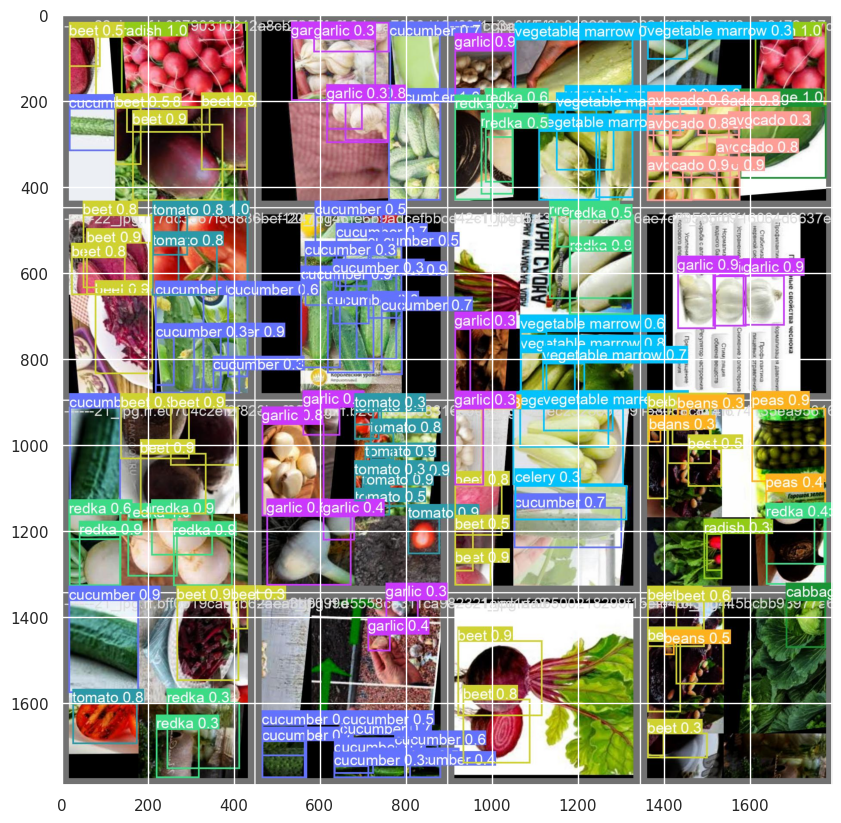

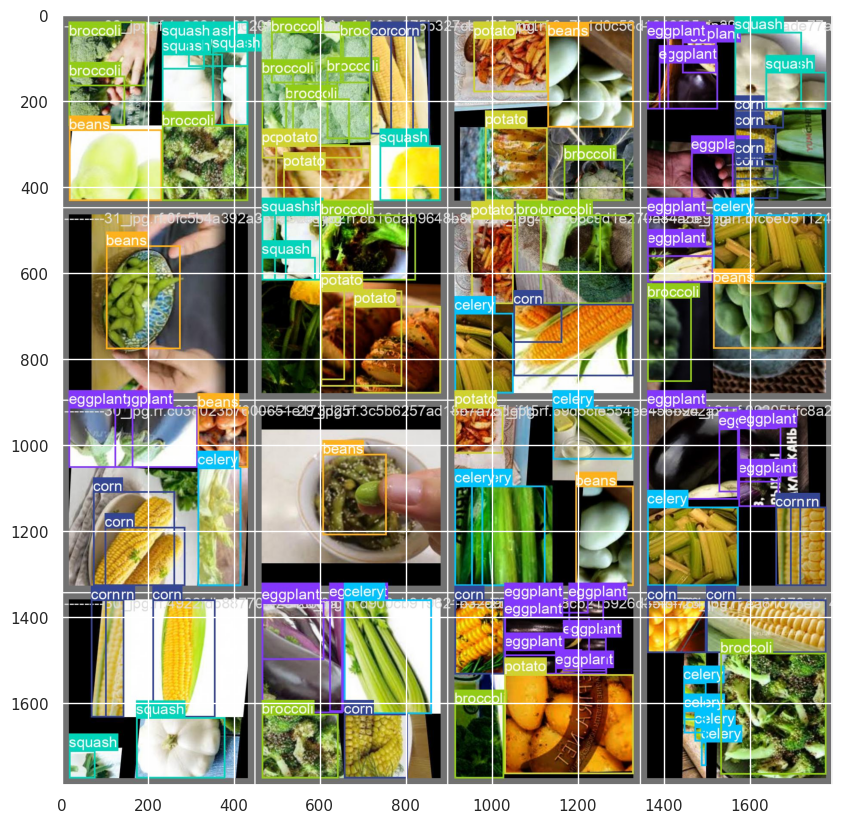

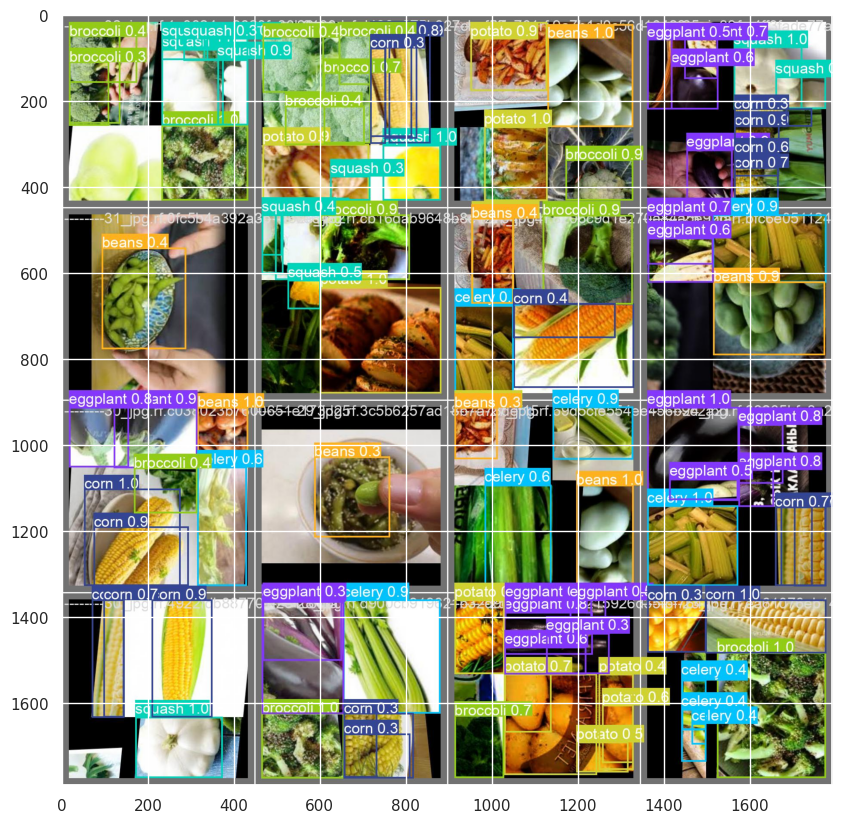

In [14]:
for path in tpaths2:
    image = Image.open(path)
    image=np.array(image)
    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.show()

In [23]:
print('Predict')
best_path0='/content/runs/detect/train/weights/best.pt'
source0='/content/ClassificationFridge.v2i/valid/images'

Predict


In [24]:
ppaths=[]
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            ppaths+=[(os.path.join(dirname, filename))]
ppaths=sorted(ppaths)
print(ppaths[0])

/content/ClassificationFridge.v2i/valid/images/--------------------------12_jpg.rf.cd2ea0b08e8e46eddf34eebd4effc73e.jpg


In [25]:
model2 = YOLO(best_path0)
print('yolo task=detect mode=predict')

yolo task=detect mode=predict


In [26]:
!yolo task=detect mode=predict model={best_path0} conf=0.4 source={source0}

Ultralytics YOLOv8.0.229 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (AMD EPYC 7B12)
Model summary (fused): 168 layers, 3011888 parameters, 0 gradients, 8.1 GFLOPs

image 1/1993 /content/ClassificationFridge.v2i/valid/images/--------------------------12_jpg.rf.cd2ea0b08e8e46eddf34eebd4effc73e.jpg: 416x416 1 brus capusta, 2 cabbages, 1 onion, 66.8ms
image 2/1993 /content/ClassificationFridge.v2i/valid/images/--------------------------18_jpg.rf.3ff07440329ac48c649295efdd1bb110.jpg: 416x416 2 brus capustas, 1 cabbage, 1 cauliflower, 1 hot pepper, 51.6ms
image 3/1993 /content/ClassificationFridge.v2i/valid/images/--------------------------18_jpg.rf.8593eb038dfccc89cdf84d98ceb4f5fa.jpg: 416x416 1 brus capusta, 1 cauliflower, 1 onion, 35.1ms
image 4/1993 /content/ClassificationFridge.v2i/valid/images/--------------------------19_jpg.rf.81e1dadfedfb159c2617aa7af06fa0e2.jpg: 416x416 1 brus capusta, 3 cauliflowers, 1 salad, 45.7ms
image 5/1993 /content/ClassificationFridge.v2i/valid/images/---------

In [27]:
print('Result of Prediction')
results = model2.predict(source0,conf=0.4)
print(len(results))

Result of Prediction


WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/1993 /content/ClassificationFridge.v2i/valid/images/--------------------------12_jpg.rf.cd2ea0b08e8e46eddf34eebd4effc73e.jpg: 416x416 1 brus capusta, 2 cabbages, 1 onion, 52.2ms
image 2/1993 /content/ClassificationFridge.v2i/valid/images/--------------------------18_jpg.rf.3ff07440329ac48c649295efdd1bb110.jpg: 416x416 2 brus capustas, 1 cabbage, 1 cauliflower, 1 hot pepper, 49.2ms
image 3/1993 /content/ClassificationFridge.

In [28]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):
    arri=pd.DataFrame(results[i].boxes.data).astype(float)
    path=ppaths[i]
    file=path.split('/')[-1]
    arri=arri.assign(file=file)
    arri=arri.assign(i=i)
    PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

,x,y,x2,y2,confidence,class,file,i
0,173.440979,231.107513,416.000000,415.980499,0.982121,22.0,--------------------------12_jpg.rf.cd2ea0b08e...,0.0
1,0.000000,0.117203,174.278748,233.853180,0.976065,7.0,--------------------------12_jpg.rf.cd2ea0b08e...,0.0
2,174.137482,0.038498,416.000000,232.517029,0.972466,8.0,--------------------------12_jpg.rf.cd2ea0b08e...,0.0
3,0.000000,230.283691,171.741943,416.000000,0.803730,8.0,--------------------------12_jpg.rf.cd2ea0b08e...,0.0
0,0.000000,207.389526,184.913727,415.319519,0.972463,10.0,--------------------------18_jpg.rf.3ff0744032...,1.0
...,...,...,...,...,...,...,...,...
0,11.363464,11.763733,402.539917,399.865295,0.912329,30.0,video5274_jpg.rf.98e6f95e737698f3fb2ed6ac6bdde...,1988.0
0,6.168488,25.642365,395.615997,415.782227,0.921441,30.0,video5354_jpg.rf.bb51af5dfbba78d1b962d5dc709e5...,1989.0
0,62.774261,64.499634,337.687164,381.292664,0.925129,30.0,video5373_jpg.rf.5a90d8150cdf217c215cd3bf215b0...,1990.0
0,16.133881,15.543671,399.007874,414.352417,0.927407,30.0,video577_jpg.rf.2e2d632529bc2f6add9b585e0d9a72...,1991.0


In [29]:
class_map = {
    0: 'Pepino',
    1: 'Abacate',
    2: 'Manjericão',
    3: 'Feijão',
    4: 'Beterraba',
    5: 'Pimentão',
    6: 'Brócolis',
    7: 'Repolho Brus Capusta',
    8: 'Repolho',
    9: 'Cenoura',
    10: 'Couve-flor',
    11: 'Aipo',
    12: 'Milho',
    13: 'Pepino',
    14: 'Ovo',
    15: 'Berinjela',
    16: 'Fasol',
    17: 'Alho',
    18: 'Pimenta',
    19: 'Eu',
    20: 'Leite',
    21: 'Cogumelo',
    22: 'Cebola',
    23: 'Ervilha',
    24: 'Batata',
    25: 'Abóbora',
    26: 'Rabanete',
    27: 'Redka',
    28: 'Salada',
    29: 'Abóbora',
    30: 'Tomate',
    31: 'Marrow Vegetal'
}

In [30]:
PBOX['class'] = PBOX['class'].apply(lambda x: class_map[int(x)])
PBOX = PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

,x,y,x2,y2,confidence,class,file,i
0,173.440979,231.107513,416.000000,415.980499,0.982121,Cebola,--------------------------12_jpg.rf.cd2ea0b08e...,0.0
1,0.000000,0.117203,174.278748,233.853180,0.976065,Repolho Brus Capusta,--------------------------12_jpg.rf.cd2ea0b08e...,0.0
2,174.137482,0.038498,416.000000,232.517029,0.972466,Repolho,--------------------------12_jpg.rf.cd2ea0b08e...,0.0
3,0.000000,230.283691,171.741943,416.000000,0.803730,Repolho,--------------------------12_jpg.rf.cd2ea0b08e...,0.0
4,0.000000,207.389526,184.913727,415.319519,0.972463,Couve-flor,--------------------------18_jpg.rf.3ff0744032...,1.0
...,...,...,...,...,...,...,...,...
11908,11.363464,11.763733,402.539917,399.865295,0.912329,Tomate,video5274_jpg.rf.98e6f95e737698f3fb2ed6ac6bdde...,1988.0
11909,6.168488,25.642365,395.615997,415.782227,0.921441,Tomate,video5354_jpg.rf.bb51af5dfbba78d1b962d5dc709e5...,1989.0
11910,62.774261,64.499634,337.687164,381.292664,0.925129,Tomate,video5373_jpg.rf.5a90d8150cdf217c215cd3bf215b0...,1990.0
11911,16.133881,15.543671,399.007874,414.352417,0.927407,Tomate,video577_jpg.rf.2e2d632529bc2f6add9b585e0d9a72...,1991.0


Abóbora                 1035
Tomate                   971
Cebola                   740
Batata                   615
Pepino                   603
Abacate                  569
Pimentão                 565
Cenoura                  556
Alho                     525
Milho                    512
Rabanete                 500
Beterraba                500
Pimenta                  479
Berinjela                426
Marrow Vegetal           419
Couve-flor               344
Redka                    339
Ervilha                  312
Brócolis                 309
Repolho                  292
Repolho Brus Capusta     262
Fasol                    244
Salada                   216
Feijão                   203
Aipo                     201
Eu                        94
Manjericão                31
Leite                     24
Ovo                       24
Cogumelo                   3
Name: class, dtype: int64

In [31]:
def draw_box2(n0):

    ipath=ppaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]
    file=ipath.split('/')[-1]

    if PBOX[PBOX['file']==file] is not None:
        box=PBOX[PBOX['file']==file]
        box=box.reset_index(drop=True)
        #display(box)

        for i in range(len(box)):
            label=box.loc[i,'class']
            x=int(box.loc[i,'x'])
            y=int(box.loc[i,'y'])
            x2=int(box.loc[i,'x2'])
            y2=int(box.loc[i,'y2'])
            #print(label,x,y,x2,y2)
            cv2.putText(image, f'{label}', (x, int(y-4)),
                        cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,0),2)
            cv2.rectangle(image,(x,y),(x2,y2),(0,255,0),2) #green

    #plt.imshow(image)
    #plt.show()

    return image

In [32]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {20+i}')
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000)

In [33]:
images2=[]
for i in tqdm(range(len(ppaths))):
    images2+=[draw_box2(i)]

  0%|          | 0/1993 [00:00<?, ?it/s]

In [34]:
create_animation(images2)